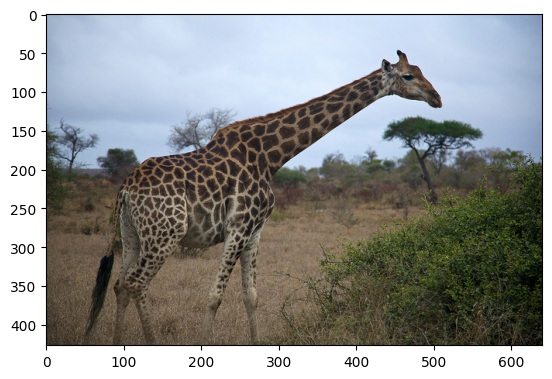

In [45]:
%matplotlib inline
from matplotlib.pyplot import imshow
import mxnet as mx  # used version '1.0.0' at time of writing
import numpy as np
import matplotlib.pyplot as plt
import mxnet as mx
from mxnet.gluon.data.vision import transforms

mx.random.seed(42) # set seed for repeatability

def plot_mx_array(array):
    """
    Array expected to be height x width x 3 (channels), and values are floats between 0 and 255.
    """
    assert array.shape[2] == 3, "RGB Channel should be last"
    imshow((array.clip(0, 255)/255).asnumpy())
    
    
mx.test_utils.download('https://raw.githubusercontent.com/dmlc/web-data/master/mxnet/doc/tutorials/data_aug/inputs/0.jpg')
example_image = mx.image.imread("0.jpg")
assert example_image.dtype == np.uint8

example_image = example_image.astype("float32")    
plot_mx_array(example_image)


def show_images(imgs, num_rows, num_cols, scale=2):
    # show augmented images in a grid layout
    aspect_ratio = imgs[0].shape[0]/imgs[0].shape[1]
    figsize = (num_cols * scale, num_rows * scale * aspect_ratio)
    _, axes = plt.subplots(num_rows, num_cols, figsize=figsize)
    for i in range(num_rows):
        for j in range(num_cols):
            axes[i][j].imshow(imgs[i * num_cols + j].asnumpy())
            axes[i][j].axes.get_xaxis().set_visible(False)
            axes[i][j].axes.get_yaxis().set_visible(False)
    plt.subplots_adjust(hspace=0.1, wspace=0)
    return axes

def apply(img, aug, num_rows=2, num_cols=4, scale=3):
    # apply augmentation multiple times to obtain different samples
    Y = [aug(img) for _ in range(num_rows * num_cols)]
    show_images(Y, num_rows, num_cols, scale)

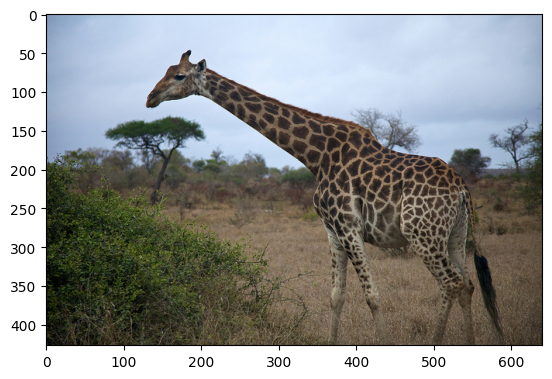

In [5]:
aug = mx.image.HorizontalFlipAug(p=1)
aug_image = aug(example_image)
plot_mx_array(aug_image)

assert example_image.shape == (427, 640, 3)
assert aug_image.shape == (427, 640, 3)

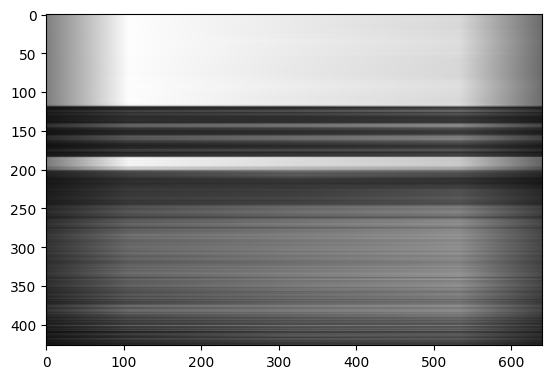

In [38]:
plot_mx_array(mx.image.random_rotate(example_image, (90,90),zoom_in=True, zoom_out=False))

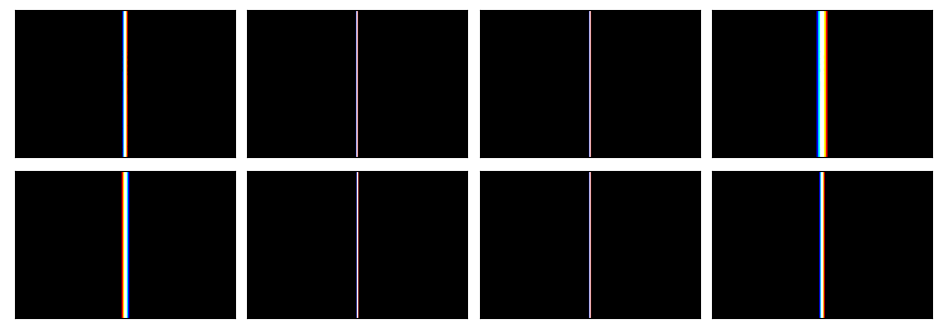

In [51]:
shape_aug = transforms.RandomRotation(angle_limits=(100, 200))
apply(example_image, shape_aug)

In [50]:
help(transforms.RandomRotation)

Help on class RandomRotation in module mxnet.gluon.data.vision.transforms:

class RandomRotation(mxnet.gluon.block.Block)
 |  RandomRotation(angle_limits, zoom_in=False, zoom_out=False, rotate_with_proba=1.0)
 |  
 |  Random rotate the input image by a random angle.
 |     Keeps the original image shape and aspect ratio.
 |  
 |  Parameters
 |  ----------
 |  angle_limits: tuple
 |      Tuple of 2 elements containing the upper and lower limit
 |      for rotation angles in degree.
 |  zoom_in : bool
 |      Zoom in image so that no padding is present in final output.
 |  zoom_out : bool
 |      Zoom out image so that the entire original image is present in final output.
 |  rotate_with_proba : float32
 |  
 |  
 |  Inputs:
 |      - **data**: input tensor with (C x H x W) or (N x C x H x W) shape.
 |  
 |  Outputs:
 |      - **out**: output tensor with (C x H x W) or (N x C x H x W) shape.
 |  
 |  Method resolution order:
 |      RandomRotation
 |      mxnet.gluon.block.Block
 |      

In [52]:
from sklearn.datasets import fetch_california_housing
import plotly.express as px

data = fetch_california_housing(as_frame=True) #A
median_income = data.frame['MedInc'] #B
fig = px.histogram(median_income) #C
fig.show()


In [53]:
from sklearn.mixture import GaussianMixture

K = 5 #A

median_income = data.frame['MedInc'].values.reshape(-1, 1) #B

gmm = GaussianMixture(n_components = K, n_init=1) #C
gmm.fit(median_income)
print(gmm.weights_)


[0.33331659 0.10225877 0.22300691 0.02582666 0.31559107]


In [54]:
import numpy as np

means = gmm.means_.reshape((1, K)) #A
stds = np.sqrt(gmm.covariances_).reshape((1, K))
median_income_normalized = (median_income - means) / (4 * stds) #B

#C
probs = gmm.predict_proba(median_income) #D
print(probs[0])
print(probs[0].sum()) #E


[7.32357781e-16 7.76863053e-01 1.87041670e-05 2.23118243e-01
 9.79085142e-24]
0.9999999999999998


In [55]:
opt_sel = np.zeros(len(median_income), dtype='int') #A 
for i, sample_prob in enumerate(probs):
    clean_probs = sample_prob + 1e-6 #B
    normalized_probs = clean_probs / clean_probs.sum() #C
    opt_sel[i] = np.random.choice(np.arange(K), p=normalized_probs) #D
print(opt_sel)


[1 1 1 ... 4 4 0]


In [94]:
from math import sqrt
def euclidean_distance2(row1, row2):
    distance = 0.0
    print(len(row1)-1)
    for i in range(len(row1)):
        print(row1[i], row2[i])
        distance += (row1[i] - row2[i])**2
    return sqrt(distance)

In [97]:
import numpy as np
def euclidean_distance(row1, row2):
    distance = sum([(p1-p2)**2 for p1, p2 in zip(row1, row2)])
    return sqrt(distance)

In [98]:
euclidean_distance([1, 2, 3, 4], [5,2,3,4])

/var/folders/x6/00594j4s2yv3swcn98bn8gxr0000gn/T/ipykernel_36894/853120849.py:5: RuntimeWarning:

invalid value encountered in sqrt



nan

In [4]:
# pip install scikit-image
!pip install opencv-python

     |████████████████████████████████| 46.4 MB 627 kB/s  eta 0:00:01
You should consider upgrading via the '/Users/benepstein/Documents/Github/dcai/.venv/bin/python -m pip install --upgrade pip' command.


In [6]:

path = "original.gif"
output_path = "out.gif"
display(ipython_image(url=path))
display(ipython_image(url=output_path))

Original has 72 frames. Frame 0 below


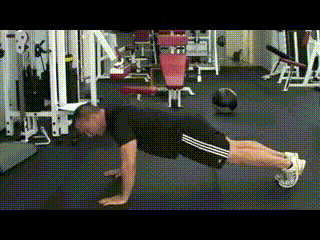

Upsampled image


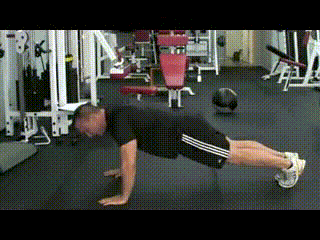

Upsampled has 144 frames
Downsampled image


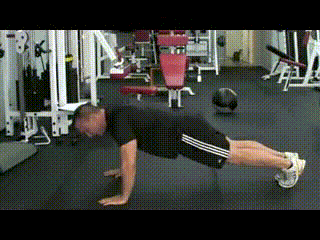

Downsampled has 14 frames


In [1]:
from IPython.display import Image as ipython_image
from PIL import Image, ImageSequence
import vidaug.augmentors as va

input_path = "original.gif"
output_up_path = "out_up.gif"
output_down_path = "out_down.gif"
display(ipython_image(url=input_path))

def gif_loader(path, modality="RGB"): #A
    frames = []
    with open(path, 'rb') as f:
        with Image.open(f) as video:
            for frame in ImageSequence.Iterator(video):
                frames.append(frame.convert(modality))
        return frames

frames = gif_loader(input_path) #B
print(f"Original has {len(frames)} frames. Frame 0 below")
display(frames[0]) # C

up_aug = va.Upsample(2.0) # D 
video_aug = up_aug(frames)  # E

video_aug[0].save(  # F 
    output_up_path, 
    save_all=True, 
    append_images=video_aug[1:], 
#     duration=100, 
    loop=0
)

print("Upsampled image")
display(ipython_image(output_up_path))
print(f"Upsampled has {len(video_aug)} frames")

down_aug = va.Downsample(0.2) # G 
video_aug_down = down_aug(frames)  # H

video_aug_down[0].save(  # I 
    output_down_path, 
    save_all=True, 
    append_images=video_aug_down[1:], 
#     duration=100, 
    loop=0
)

print("Downsampled image")
display(ipython_image(output_down_path))
print(f"Downsampled has {len(video_aug_down)} frames")


Original frame 0 below


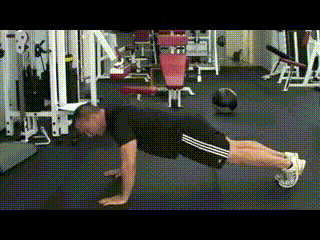

Flipped image


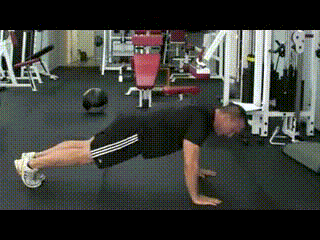

Flipped frame 0 below


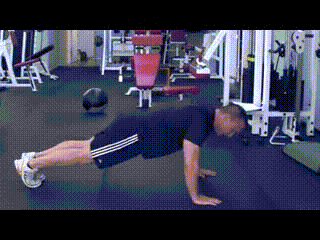

In [2]:
from IPython.display import Image as ipython_image
from PIL import Image, ImageSequence
import vidaug.augmentors as va

input_path = "original.gif"
output_path = "flipped.gif"
display(ipython_image(url=input_path))

def gif_loader(path, modality="RGB"): #A
    frames = []
    with open(path, 'rb') as f:
        with Image.open(f) as video:
            for frame in ImageSequence.Iterator(video):
                frames.append(frame.convert(modality))
        return frames

frames = gif_loader(input_path) #B
print(f"Original frame 0 below")
display(frames[0]) # C

p = 1 # D 
sometimes = lambda aug: va.Sometimes(p, aug)  # E
seq = va.Sequential([
    sometimes(va.HorizontalFlip()) # D
])
video_aug = seq(frames) # F

video_aug[0].save(  # G 
    output_path, 
    save_all=True, 
    append_images=video_aug[1:], 
    loop=0
)

print("Flipped image")
display(ipython_image(output_path))
print("Flipped frame 0 below")
display(video_aug[0])

Original frame 0 below


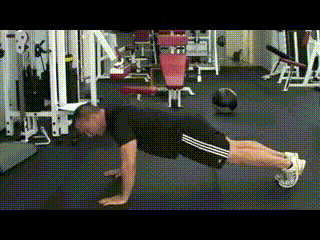

Center cropped image


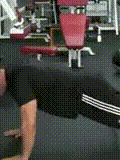

Center crop frame 0 below


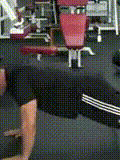

In [1]:
from IPython.display import Image as ipython_image
from PIL import Image, ImageSequence
import vidaug.augmentors as va

input_path = "original.gif"
output_path = "center_cropped.gif"
display(ipython_image(url=input_path))

def gif_loader(path, modality="RGB"): #A
    frames = []
    with open(path, 'rb') as f:
        with Image.open(f) as video:
            for frame in ImageSequence.Iterator(video):
                frames.append(frame.convert(modality))
        return frames

frames = gif_loader(input_path) #B
print(f"Original frame 0 below")
display(frames[0]) # C

p = 1 # D 
sometimes = lambda aug: va.Sometimes(p, aug)  # E
seq = va.Sequential([
    sometimes(va.CenterCrop((frames[0].width*0.5, frames[0].height*0.5))) # D
])
video_aug = seq(frames) # F

video_aug[0].save(  # G 
    output_path, 
    save_all=True, 
    append_images=video_aug[1:], 
    loop=0
)

print("Center cropped image")
display(ipython_image(output_path))
print("Center crop frame 0 below")
display(video_aug[0]) 

In [2]:
output_path

NameError: name 'output_path' is not defined

Original frame 0 below


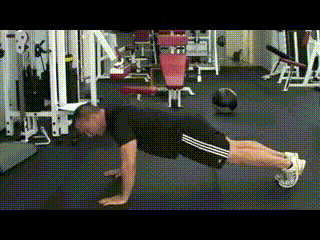

Converting
SuperPixel image


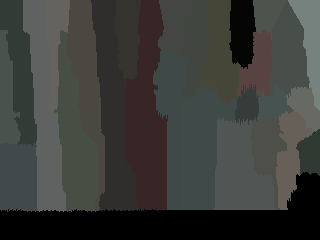

SuperPixel frame 0 below


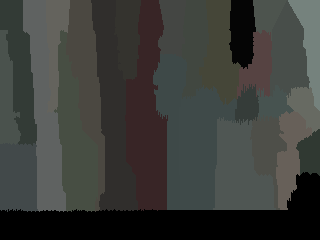

In [1]:
from IPython.display import Image as ipython_image
from PIL import Image, ImageSequence
import vidaug.augmentors as va

input_path = "original.gif"
output_path = "super_pixel.gif"
display(ipython_image(url=input_path))

def gif_loader(path, modality="RGB"): #A
    frames = []
    with open(path, 'rb') as f:
        with Image.open(f) as video:
            for frame in ImageSequence.Iterator(video):
                frames.append(frame.convert(modality))
        return frames

frames = gif_loader(input_path) #B
print(f"Original frame 0 below")
display(frames[0]) # C

aug = va.Superpixel(p_replace=1.0, n_segments=144, interpolation="nearest")
video_aug = aug(frames) # D

video_aug[0].save(  # E 
    output_path, 
    save_all=True, 
    append_images=video_aug[1:], 
    loop=0
)

print("SuperPixel image")
display(ipython_image(output_path))
print("SuperPixel frame 0 below")
display(video_aug[0]) 

Converting
SuperPixel frame 0 below


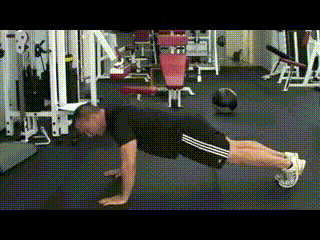

In [14]:
from IPython.display import Image as ipython_image
from PIL import Image, ImageSequence
import vidaug.augmentors as va

input_path = "original.gif"
output_path = "super_pixel.gif"

def gif_loader(path, modality="RGB"): #A
    frames = []
    with open(path, 'rb') as f:
        with Image.open(f) as video:
            for frame in ImageSequence.Iterator(video):
                frames.append(frame.convert(modality))
        return frames

frames = gif_loader(input_path) #B
aug2 = va.Superpixel(p_replace=1.01, n_segments=200, interpolation="nearest")
video_aug2 = aug2(frames) # D

!rm -rf test_sup.gif
# video_aug2[0].save(  # E 
#     "test_sup.gif", 
#     save_all=True, 
#     append_images=video_aug2[1:], 
#     loop=0
# )

# print("SuperPixel image")
# display(ipython_image("test_sup.gif"))
print("SuperPixel frame 0 below")
display(video_aug2[0]) 

In [2]:
!rm blurred.gif

rm: blurred.gif: No such file or directory


Original frame 0 below


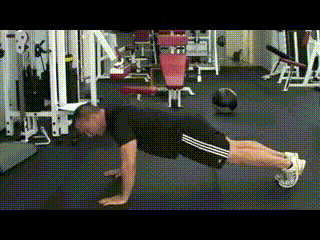

Blurred image


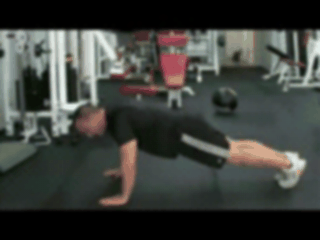

Blurred frame 0 below


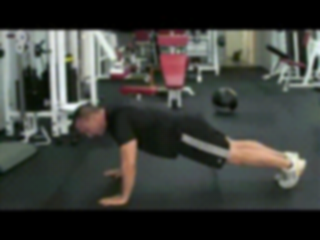

In [3]:
from IPython.display import Image as ipython_image
from PIL import Image, ImageSequence, ImageFilter
import vidaug.augmentors as va

input_path = "original.gif"
output_path = "blurred.gif"
display(ipython_image(url=input_path))

def gif_loader(path, modality="RGB"): #A
    frames = []
    with open(path, 'rb') as f:
        with Image.open(f) as video:
            for frame in ImageSequence.Iterator(video):
                frames.append(frame.convert(modality))
        return frames

frames = gif_loader(input_path) #B
print(f"Original frame 0 below")
display(frames[0]) # C

p = 1 # D 
sometimes = lambda aug: va.Sometimes(p, aug)  # E
seq = va.Sequential([
    sometimes(va.GaussianBlur(sigma=1.5)) # D
])
video_aug = seq(frames) # F

video_aug[0].save(  # G 
    output_path, 
    save_all=True, 
    append_images=video_aug[1:], 
    loop=0
)

print("Blurred image")
display(ipython_image(output_path))
print("Blurred frame 0 below")
display(video_aug[0]) 

In [7]:
# dir(va)
help(va.GaussianBlur)

Help on class GaussianBlur in module vidaug.augmentors.geometric:

class GaussianBlur(builtins.object)
 |  GaussianBlur(sigma)
 |  
 |  Augmenter to blur images using gaussian kernels.
 |  
 |  Args:
 |      sigma (float): Standard deviation of the gaussian kernel.
 |  
 |  Methods defined here:
 |  
 |  __call__(self, clip)
 |      Call self as a function.
 |  
 |  __init__(self, sigma)
 |      Initialize self.  See help(type(self)) for accurate signature.
 |  
 |  ----------------------------------------------------------------------
 |  Data descriptors defined here:
 |  
 |  __dict__
 |      dictionary for instance variables (if defined)
 |  
 |  __weakref__
 |      list of weak references to the object (if defined)



In [85]:
!rm -rf test.gif
print(len(video_aug[1:]))
video_aug[0].save(  # save augmentad frames as gif 
    "test.gif", 
    save_all=True, 
    append_images=video_aug[:10], 
    duration=-1, 
    loop=0
)

143


In [77]:
sys.getsizeof(video_aug[0])

48

In [78]:
sys.getsizeof(frames[0])

48

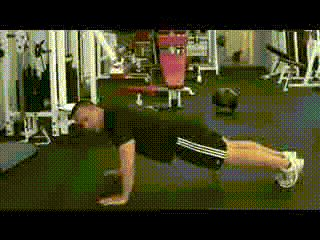

In [80]:
display(ipython_image("test.gif"))

In [66]:
!ls -lsah | grep gif

  944 -rw-r--r--@  1 benepstein  staff   471K Dec 11 12:17 original.gif
 4112 -rw-r--r--@  1 benepstein  staff   1.4M Dec 11 12:56 out.gif
 2792 -rw-r--r--   1 benepstein  staff   1.4M Dec 11 12:59 test.gif


In [73]:
import sys
with open("original.gif", 'rb') as f:
    print(sys.getsizeof(f.read()))
    with Image.open(f) as video:
        print(video.n_frames)
#         display(video)
        print(len(list(ImageSequence.Iterator(video))))

482747
72
72


In [74]:
with open("test.gif", 'rb') as f:
    print(sys.getsizeof(f.read()))
    with Image.open(f) as video:
        print(video.n_frames)
#         display(video)
        print(len(list(ImageSequence.Iterator(video))))

1426441
72
72
